<a href="https://colab.research.google.com/github/teegrun/colab/blob/main/GooglePlayStore.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import packages

In [1048]:
#Notwendige Packages importieren

import pandas as pd
import glob
import os
import numpy as np
import warnings
import statistics
import datetime
import random
import seaborn as sns
color = sns.color_palette()
sns.set(rc={'figure.figsize':(25,15)})
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from mpl_toolkits.axes_grid1 import make_axes_locatable
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasRegressor
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from keras.utils import np_utils
from string import ascii_letters
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import MinMaxScaler
from numpy import loadtxt
from keras.models import Sequential
from keras.layers import Dense
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix
from numpy.random import RandomState

##
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier, XGBRFClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image  
import pydotplus
##

%matplotlib inline
import plotly
# connected=True means it will download the latest version of plotly javascript library.
plotly.offline.init_notebook_mode(connected=True)
import plotly.graph_objs as go
from plotly.offline import iplot
import plotly.figure_factory as ff
import plotly.express as px
import cufflinks as cf
import warnings
warnings.filterwarnings('ignore')
#import packages

from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
import pydotplus
from IPython.display import Image

from sklearn.model_selection import train_test_split
#from sklearn.neighbors import KNeighborsClassifier as knn
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn import datasets
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation

#2


import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import plot_tree
from sklearn import metrics
from IPython.display import Image
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.tree import export_graphviz
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from six import StringIO
import pydotplus
import scipy.stats as st
import statsmodels.api as sm
from statsmodels.tools import add_constant as add_constant
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier, XGBRFClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split



In [1049]:
#Visualisierung mittels plotly aktivieren
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
  #SEHR WICHTIG! steht für die Visualisierung

# Data import


In [1050]:
#Datensatz importieren
rawdata = pd.read_csv('https://raw.githubusercontent.com/teegrun/colab/main/googleplaystore.csv')

In [1051]:
#Importierter Datensatz anzeigen
print(rawdata)


                                                     App  ...         Android Ver
0         Photo Editor & Candy Camera & Grid & ScrapBook  ...        4.0.3 and up
1                                    Coloring book moana  ...        4.0.3 and up
2      U Launcher Lite – FREE Live Cool Themes, Hide ...  ...        4.0.3 and up
3                                  Sketch - Draw & Paint  ...          4.2 and up
4                  Pixel Draw - Number Art Coloring Book  ...          4.4 and up
...                                                  ...  ...                 ...
10836                                   Sya9a Maroc - FR  ...          4.1 and up
10837                   Fr. Mike Schmitz Audio Teachings  ...          4.1 and up
10838                             Parkinson Exercices FR  ...          2.2 and up
10839                      The SCP Foundation DB fr nn5n  ...  Varies with device
10840      iHoroscope - 2018 Daily Horoscope & Astrology  ...  Varies with device

[10841 rows x 1

In [1052]:
#Importierter Datensatz anzeigen
rawdata.head()

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19M,"10,000+",Free,0,Everyone,Art & Design,"January 7, 2018",1.0.0,4.0.3 and up
1,Coloring book moana,ART_AND_DESIGN,3.9,967,14M,"500,000+",Free,0,Everyone,Art & Design;Pretend Play,"January 15, 2018",2.0.0,4.0.3 and up
2,"U Launcher Lite – FREE Live Cool Themes, Hide ...",ART_AND_DESIGN,4.7,87510,8.7M,"5,000,000+",Free,0,Everyone,Art & Design,"August 1, 2018",1.2.4,4.0.3 and up
3,Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644,25M,"50,000,000+",Free,0,Teen,Art & Design,"June 8, 2018",Varies with device,4.2 and up
4,Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967,2.8M,"100,000+",Free,0,Everyone,Art & Design;Creativity,"June 20, 2018",1.1,4.4 and up


# Data info


In [1053]:
#Informationen über den Datensatz anzeigen
rawdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10841 entries, 0 to 10840
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   App             10841 non-null  object 
 1   Category        10841 non-null  object 
 2   Rating          9367 non-null   float64
 3   Reviews         10841 non-null  object 
 4   Size            10841 non-null  object 
 5   Installs        10841 non-null  object 
 6   Type            10840 non-null  object 
 7   Price           10841 non-null  object 
 8   Content Rating  10840 non-null  object 
 9   Genres          10841 non-null  object 
 10  Last Updated    10841 non-null  object 
 11  Current Ver     10833 non-null  object 
 12  Android Ver     10838 non-null  object 
dtypes: float64(1), object(12)
memory usage: 1.1+ MB


In [1054]:
#Form des Datensatzes anzeigen
rawdata.shape

(10841, 13)

In [1055]:
#Einzigartige Apps anzeigen
rawdata['App'].nunique()

9660

In [1056]:
#Die Summe der doppelten Einträge anzeigen
rawdata.App.duplicated().sum()

1181

In [1057]:
#Anzahl der einzelnen Kategorien anzeigen
rawdata['Category'].nunique()


34

In [1058]:
#Einzelne Kategorien anzeigen
rawdata.Category.unique()

array(['ART_AND_DESIGN', 'AUTO_AND_VEHICLES', 'BEAUTY',
       'BOOKS_AND_REFERENCE', 'BUSINESS', 'COMICS', 'COMMUNICATION',
       'DATING', 'EDUCATION', 'ENTERTAINMENT', 'EVENTS', 'FINANCE',
       'FOOD_AND_DRINK', 'HEALTH_AND_FITNESS', 'HOUSE_AND_HOME',
       'LIBRARIES_AND_DEMO', 'LIFESTYLE', 'GAME', 'FAMILY', 'MEDICAL',
       'SOCIAL', 'SHOPPING', 'PHOTOGRAPHY', 'SPORTS', 'TRAVEL_AND_LOCAL',
       'TOOLS', 'PERSONALIZATION', 'PRODUCTIVITY', 'PARENTING', 'WEATHER',
       'VIDEO_PLAYERS', 'NEWS_AND_MAGAZINES', 'MAPS_AND_NAVIGATION',
       '1.9'], dtype=object)

# Format & adjust data

In [1059]:
#Datenbereinigung: Duplikate entfernen
rawdata.drop_duplicates(subset='App', inplace=True)

#Unerwünschte Einträge anpassen
rawdata = rawdata[rawdata['Android Ver'] != np.nan]
rawdata = rawdata[rawdata['Android Ver'] != 'NaN']
rawdata = rawdata[rawdata['Installs'] != 'Free']
rawdata = rawdata[rawdata['Installs'] != 'Paid']
rawdata['Size'] = rawdata['Size'].apply(lambda x: str(x).replace('Varies with device', 'NaN') if 'Varies with device' in str(x) else x)

#"+" und "," aus Installs entfernen
rawdata['Installs'] = rawdata['Installs'].apply(lambda x: x.replace('+', '') if '+' in str(x) else x)
rawdata['Installs'] = rawdata['Installs'].apply(lambda x: x.replace(',', '') if ',' in str(x) else x)
rawdata['Installs'] = rawdata['Installs'].apply(lambda x: int(x))

# "M" entfernen, "k" ersetzen und durch 10^-3 dividieren
rawdata['Size'] = rawdata['Size'].apply(lambda x: str(x).replace('M', '') if 'M' in str(x) else x)
rawdata['Size'] = rawdata['Size'].apply(lambda x: str(x).replace(',', '') if 'M' in str(x) else x)
rawdata['Size'] = rawdata['Size'].apply(lambda x: float(str(x).replace('k', '')) / 1000 if 'k' in str(x) else x)

#Type der Informationen bestimmen
rawdata['Size'] = rawdata['Size'].apply(lambda x: float(x))
rawdata['Installs'] = rawdata['Installs'].apply(lambda x: float(x))
rawdata['Reviews'] = rawdata['Reviews'].apply(lambda x: int(x))

# "$" ersetzen bzw. entfernen
rawdata['Price'] = rawdata['Price'].apply(lambda x: str(x).replace('$', '') if '$' in str(x) else str(x))
rawdata['Price'] = rawdata['Price'].apply(lambda x: float(x))

#Länge der Namen definieren und als Spalte anzeigen
rawdata['NameLenght'] = rawdata['App'].apply(len)

In [1060]:
#Bereinigten Datensatz anzeigen
print(rawdata)

                                                     App  ... NameLenght
0         Photo Editor & Candy Camera & Grid & ScrapBook  ...         46
1                                    Coloring book moana  ...         19
2      U Launcher Lite – FREE Live Cool Themes, Hide ...  ...         50
3                                  Sketch - Draw & Paint  ...         21
4                  Pixel Draw - Number Art Coloring Book  ...         37
...                                                  ...  ...        ...
10836                                   Sya9a Maroc - FR  ...         16
10837                   Fr. Mike Schmitz Audio Teachings  ...         32
10838                             Parkinson Exercices FR  ...         22
10839                      The SCP Foundation DB fr nn5n  ...         29
10840      iHoroscope - 2018 Daily Horoscope & Astrology  ...         45

[9659 rows x 14 columns]


# Descriptive statistics

In [1159]:
#Tortendiagramm: Anzahl der Apps pro Kategorie
number_of_apps_in_category = rawdata['Category'].value_counts().sort_values(ascending=True)

enable_plotly_in_cell()
data = [go.Pie(
        labels = number_of_apps_in_category.index,
        values = number_of_apps_in_category.values,
        hoverinfo = 'label+value'
    
)]

plotly.offline.iplot(data, filename = number_of_apps_in_category)
plt.show()
plt.savefig('Pie chart.png')

<Figure size 432x288 with 0 Axes>

In [1160]:
#Balkendiagramm: Anzahl der Apps pro Kategorie
number_of_apps_in_category = rawdata['Category'].value_counts().sort_values(ascending=True)


enable_plotly_in_cell()

data = [go.Bar(
        x = number_of_apps_in_category.index,
        y = number_of_apps_in_category.values,
        

    
)]

plotly.offline.iplot(data, filename = number_of_apps_in_category)
plt.show()
plt.savefig('Balkendiagramm.png')

<Figure size 432x288 with 0 Axes>

In [1063]:
#Summe der Installationen pro Kategorie
installs_per_category = rawdata.groupby('Category')[['Installs']].sum()

#Lambda-Funktion für die Umwandlung der wissenschaftlichen Schreibweise
installs_per_category.apply(lambda x: '%.f' % x, axis=1)

Category
ART_AND_DESIGN           114338100
AUTO_AND_VEHICLES         53130211
BEAUTY                    27197050
BOOKS_AND_REFERENCE     1665969576
BUSINESS                 697164865
COMICS                    44981150
COMMUNICATION          11038276251
DATING                   140926107
EDUCATION                352952000
ENTERTAINMENT           2113660000
EVENTS                    15973161
FAMILY                  4427941505
FINANCE                  455348734
FOOD_AND_DRINK           211798751
GAME                   13878924415
HEALTH_AND_FITNESS      1144022512
HOUSE_AND_HOME            97212461
LIBRARIES_AND_DEMO        52995910
LIFESTYLE                503823539
MAPS_AND_NAVIGATION      503281890
MEDICAL                   38193177
NEWS_AND_MAGAZINES      2369217760
PARENTING                 31521110
PERSONALIZATION         1532494782
PHOTOGRAPHY             4649147655
PRODUCTIVITY            5793091369
SHOPPING                1400348785
SOCIAL                  5487867902
SPORTS     

In [1064]:
#Balkendiagramm: Summe der Installationen pro Kategorie


number_of_apps_in_category = rawdata['Category'].value_counts().sort_values(ascending=True)


enable_plotly_in_cell()

data = [go.Bar(
        
        x = number_of_apps_in_category.index. sort_values (ascending=True),
        y = installs_per_category['Installs'],
    
      
      
        
    
)]
plotly.offline.iplot(data, filename = installs_per_category)

In [1065]:
#Mittelwert der Installationen pro Kategorie 
mean_per_category = rawdata.groupby('Category')['Installs'].mean()

#Lambda-Funktion für die Umwandlung der wissenschaftlichen Schreibweise
mean_per_category.apply(lambda x: '%.f' % x)

Category
ART_AND_DESIGN          1786533
AUTO_AND_VEHICLES        625061
BEAUTY                   513152
BOOKS_AND_REFERENCE     7504367
BUSINESS                1659916
COMICS                   803235
COMMUNICATION          35042147
DATING                   824129
EDUCATION               2965983
ENTERTAINMENT          20722157
EVENTS                   249581
FAMILY                  2416999
FINANCE                 1319851
FOOD_AND_DRINK          1891060
GAME                   14472288
HEALTH_AND_FITNESS      3972300
HOUSE_AND_HOME          1313682
LIBRARIES_AND_DEMO       630904
LIFESTYLE               1365375
MAPS_AND_NAVIGATION     3841846
MEDICAL                   96692
NEWS_AND_MAGAZINES      9327629
PARENTING                525352
PERSONALIZATION         4075784
PHOTOGRAPHY            16545009
PRODUCTIVITY           15489549
SHOPPING                6932420
SOCIAL                 22961790
SPORTS                  3373768
TOOLS                   9675661
TRAVEL_AND_LOCAL       13218663

In [1066]:
#Balkendiagramm: Mittelwert der Installationen pro Kategorie 
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = rawdata.groupby('Category')['Installs'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_per_category)

In [1067]:
#Mittelwert der App-Größen pro Kategorie 
mean_per_category = rawdata.groupby('Category')['Size'].mean()

#Lambda-Funktion für die gewünschte Schreibweise (2 Dezimalstellen)
mean_per_category.apply(lambda x: '%.2f' % x)

Category
ART_AND_DESIGN         12.37
AUTO_AND_VEHICLES      20.04
BEAUTY                 13.80
BOOKS_AND_REFERENCE    13.13
BUSINESS               13.87
COMICS                 13.79
COMMUNICATION          11.31
DATING                 15.66
EDUCATION              19.06
ENTERTAINMENT          23.04
EVENTS                 13.96
FAMILY                 27.19
FINANCE                17.37
FOOD_AND_DRINK         20.49
GAME                   41.87
HEALTH_AND_FITNESS     20.67
HOUSE_AND_HOME         15.97
LIBRARIES_AND_DEMO     10.60
LIFESTYLE              14.84
MAPS_AND_NAVIGATION    16.37
MEDICAL                19.19
NEWS_AND_MAGAZINES     12.47
PARENTING              22.51
PERSONALIZATION        11.22
PHOTOGRAPHY            15.67
PRODUCTIVITY           12.34
SHOPPING               15.49
SOCIAL                 15.98
SPORTS                 24.06
TOOLS                   8.78
TRAVEL_AND_LOCAL       24.20
VIDEO_PLAYERS          15.79
WEATHER                12.68
Name: Size, dtype: object

In [1068]:
#Balkendiagramm: Mittelwert der App-Größen pro Kategorie
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = rawdata.groupby('Category')['Size'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_per_category)

In [1069]:
#Durchschnittliche Namenslänge (Mittelwert) pro Kategorie 
mean_price_per_category = rawdata.groupby('Category')['NameLenght'].mean()

#Lambda-Funktion für die gewünschte Schreibweise (1 Dezimalstelle)
mean_price_per_category.apply(lambda x: '%.1f' % x)

Category
ART_AND_DESIGN         30.4
AUTO_AND_VEHICLES      27.0
BEAUTY                 25.7
BOOKS_AND_REFERENCE    22.0
BUSINESS               17.8
COMICS                 29.0
COMMUNICATION          21.1
DATING                 29.0
EDUCATION              25.2
ENTERTAINMENT          22.7
EVENTS                 22.2
FAMILY                 22.7
FINANCE                20.4
FOOD_AND_DRINK         22.7
GAME                   21.6
HEALTH_AND_FITNESS     24.5
HOUSE_AND_HOME         31.3
LIBRARIES_AND_DEMO     20.8
LIFESTYLE              20.4
MAPS_AND_NAVIGATION    23.2
MEDICAL                20.8
NEWS_AND_MAGAZINES     20.4
PARENTING              27.9
PERSONALIZATION        25.6
PHOTOGRAPHY            24.1
PRODUCTIVITY           20.9
SHOPPING               23.2
SOCIAL                 22.9
SPORTS                 20.5
TOOLS                  21.2
TRAVEL_AND_LOCAL       22.9
VIDEO_PLAYERS          21.7
WEATHER                24.8
Name: NameLenght, dtype: object

In [1070]:
#Balkendiagramm: Durchschnittliche Namenslänge (Mittelwert) pro Kategorie 
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = rawdata.groupby('Category')['NameLenght'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_price_per_category)

In [1071]:
#Durchschnittlicher Preis (Mittelwert) pro Kategorie 
mean_price_per_category = rawdata.groupby('Category')['Price'].mean()

#Lambda-Funktion für die gewünschte Schreibweise (2 Dezimalstellen)
mean_price_per_category.apply(lambda x: '%.2f' % x)

Category
ART_AND_DESIGN         0.09
AUTO_AND_VEHICLES      0.16
BEAUTY                 0.00
BOOKS_AND_REFERENCE    0.54
BUSINESS               0.42
COMICS                 0.00
COMMUNICATION          0.26
DATING                 0.16
EDUCATION              0.15
ENTERTAINMENT          0.08
EVENTS                 1.72
FAMILY                 1.31
FINANCE                8.41
FOOD_AND_DRINK         0.08
GAME                   0.30
HEALTH_AND_FITNESS     0.22
HOUSE_AND_HOME         0.00
LIBRARIES_AND_DEMO     0.01
LIFESTYLE              6.40
MAPS_AND_NAVIGATION    0.21
MEDICAL                2.52
NEWS_AND_MAGAZINES     0.02
PARENTING              0.16
PERSONALIZATION        0.40
PHOTOGRAPHY            0.42
PRODUCTIVITY           0.67
SHOPPING               0.03
SOCIAL                 0.07
SPORTS                 0.31
TOOLS                  0.32
TRAVEL_AND_LOCAL       0.23
VIDEO_PLAYERS          0.06
WEATHER                0.41
Name: Price, dtype: object

In [1072]:
#Balkendiagramm: Durchschnittlicher Preis (Mittelwert) pro Kategorie 
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = rawdata.groupby('Category')['Price'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_price_per_category)

In [1073]:
#Höchste Preise pro Kategorie
max_price_per_category = rawdata.groupby('Category')['Price'].max()

#Lambda-Funktion für die gewünschte Schreibweise (2 Dezimalstellen)
max_price_per_category.apply(lambda x: '%.2f' % x)

Category
ART_AND_DESIGN           1.99
AUTO_AND_VEHICLES        9.99
BEAUTY                   0.00
BOOKS_AND_REFERENCE      6.49
BUSINESS                89.99
COMICS                   0.00
COMMUNICATION           19.99
DATING                   7.99
EDUCATION                5.99
ENTERTAINMENT            4.99
EVENTS                 109.99
FAMILY                 399.99
FINANCE                399.99
FOOD_AND_DRINK           4.99
GAME                    17.99
HEALTH_AND_FITNESS       9.99
HOUSE_AND_HOME           0.00
LIBRARIES_AND_DEMO       0.99
LIFESTYLE              400.00
MAPS_AND_NAVIGATION     11.99
MEDICAL                200.00
NEWS_AND_MAGAZINES       2.99
PARENTING                4.99
PERSONALIZATION          9.99
PHOTOGRAPHY             29.99
PRODUCTIVITY           154.99
SHOPPING                 2.99
SOCIAL                  13.99
SPORTS                  29.99
TOOLS                   25.99
TRAVEL_AND_LOCAL         8.99
VIDEO_PLAYERS            5.99
WEATHER                  6.99
N

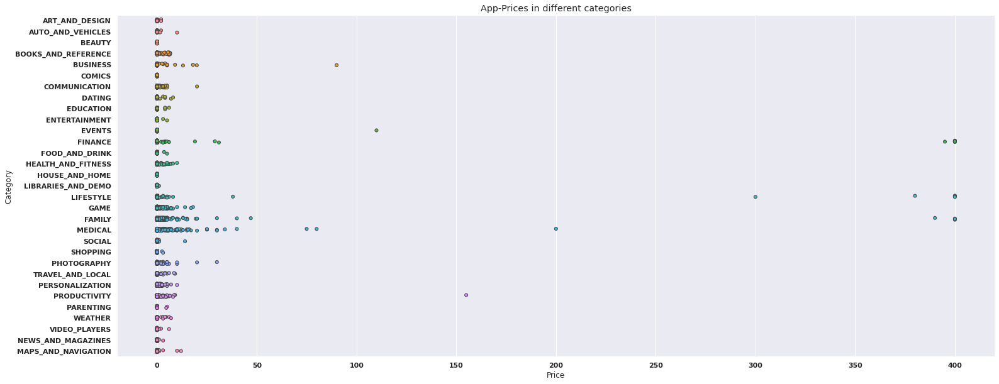

In [1074]:
#App-Preise für alle Kategorien visualisieren
subset_rawdata = rawdata[rawdata.Category.isin(['ART_AND_DESIGN', 'AUTO_AND_VEHICLES', 'BEAUTY', 'BOOKS_AND_REFERENCE' , 'BUSINESS', 
                                 'COMICS', 'COMMUNICATION', 'DATING', 'EDUCATION', 'ENTERTAINMENT', 'EVENTS', 'FAMILY', 
                                 'FINANCE', 'FOOD_AND_DRINK', 'GAME', 'HEALTH_AND_FITNESS', 'HOUSE_AND_HOME', 
                                 'LIBRARIES_AND_DEMO', 'LIFESTYLE', 'MAPS_AND_NAVIGATION', 'MEDICAL', 'NEWS_AND_MAGAZINES', 
                                 'PARENTING', 'PERSONALIZATION', 'PHOTOGRAPHY','PRODUCTIVITY', 'SHOPPING', 'SOCIAL', 'SPORTS'
                                  'TOOLS', 'TRAVEL_AND_LOCAL','VIDEO_PLAYERS', 'WEATHER'])]
sns.set_style('darkgrid')
fig, ax = plt.subplots()
fig.set_size_inches(25, 10)
p = sns.stripplot(x="Price", y="Category", data=subset_rawdata, jitter=True, linewidth=1)
title = ax.set_title('App-Prices in different categories')


In [1075]:
#Durchschnittliches Rating (Mittelwert) pro Kategorie 
mean_rating_per_category = rawdata.groupby('Category')['Rating'].mean()

#Lambda-Funktion für die gewünschte Schreibweise (2 Dezimalstellen)
mean_rating_per_category.apply(lambda x: '%.2f' % x)

Category
ART_AND_DESIGN         4.36
AUTO_AND_VEHICLES      4.19
BEAUTY                 4.28
BOOKS_AND_REFERENCE    4.34
BUSINESS               4.10
COMICS                 4.18
COMMUNICATION          4.12
DATING                 3.97
EDUCATION              4.36
ENTERTAINMENT          4.14
EVENTS                 4.44
FAMILY                 4.18
FINANCE                4.12
FOOD_AND_DRINK         4.17
GAME                   4.25
HEALTH_AND_FITNESS     4.24
HOUSE_AND_HOME         4.15
LIBRARIES_AND_DEMO     4.18
LIFESTYLE              4.09
MAPS_AND_NAVIGATION    4.04
MEDICAL                4.17
NEWS_AND_MAGAZINES     4.12
PARENTING              4.30
PERSONALIZATION        4.33
PHOTOGRAPHY            4.16
PRODUCTIVITY           4.18
SHOPPING               4.23
SOCIAL                 4.25
SPORTS                 4.22
TOOLS                  4.04
TRAVEL_AND_LOCAL       4.07
VIDEO_PLAYERS          4.04
WEATHER                4.24
Name: Rating, dtype: object

In [1076]:
#Balkendiagramm: Durchschnittliches Rating (Mittelwert) pro Kategorie 
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = rawdata.groupby('Category')['Rating'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_rating_per_category)

# Correlations

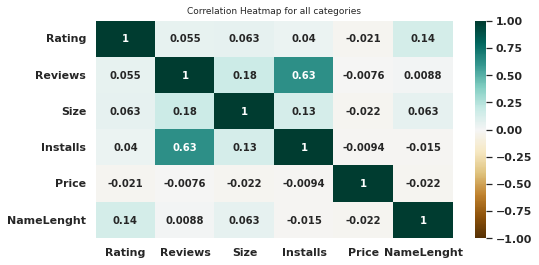

In [1077]:
#Heatmap für alle Kategorien
plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(rawdata.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap for all categories', fontdict={'fontsize':9}, pad=7);


In [1078]:
#Datensatz für die einzelnen Heatmaps vorbereiten
cat_ART_AND_DESIGN = rawdata[(rawdata.Category == 'ART_AND_DESIGN')]
cat_AUTO_AND_VEHICLES = rawdata[(rawdata.Category == 'AUTO_AND_VEHICLES')]
cat_BEAUTY = rawdata[(rawdata.Category == 'BEAUTY')]
cat_BOOKS_AND_REFERENCE = rawdata[(rawdata.Category == 'BOOKS_AND_REFERENCE')]
cat_BUSINESS = rawdata[(rawdata.Category == 'BUSINESS')]
cat_COMICS = rawdata[(rawdata.Category == 'COMICS')]
cat_COMMUNICATION = rawdata[(rawdata.Category == 'COMMUNICATION')]
cat_DATING = rawdata[(rawdata.Category == 'DATING')]
cat_EDUCATION = rawdata[(rawdata.Category == 'EDUCATION')]
cat_ENTERTAINMENT = rawdata[(rawdata.Category == 'ENTERTAINMENT')]
cat_EVENTS = rawdata[(rawdata.Category == 'EVENTS')]
cat_FAMILY = rawdata[(rawdata.Category == 'FAMILY')]
cat_FINANCE = rawdata[(rawdata.Category == 'FINANCE')]
cat_FOOD_AND_DRINK = rawdata[(rawdata.Category == 'FOOD_AND_DRINK')]
cat_GAME = rawdata[(rawdata.Category == 'GAME')]
cat_HEALTH_AND_FITNESS = rawdata[(rawdata.Category == 'HEALTH_AND_FITNESS')]
cat_HOUSE_AND_HOME = rawdata[(rawdata.Category == 'HOUSE_AND_HOME')]
cat_LIBRARIES_AND_DEMO = rawdata[(rawdata.Category == 'LIBRARIES_AND_DEMO')]
cat_LIFESTYLE = rawdata[(rawdata.Category == 'LIFESTYLE')]
cat_MAPS_AND_NAVIGATION = rawdata[(rawdata.Category == 'MAPS_AND_NAVIGATION')]
cat_MEDICAL = rawdata[(rawdata.Category == 'MEDICAL')]
cat_NEWS_AND_MAGAZINES = rawdata[(rawdata.Category == 'NEWS_AND_MAGAZINES')]
cat_PARENTING = rawdata[(rawdata.Category == 'PARENTING')]
cat_PERSONALIZATION = rawdata[(rawdata.Category == 'PERSONALIZATION')]
cat_PHOTOGRAPHY = rawdata[(rawdata.Category == 'PHOTOGRAPHY')]
cat_PRODUCTIVITY = rawdata[(rawdata.Category == 'PRODUCTIVITY')]
cat_SHOPPING = rawdata[(rawdata.Category == 'SHOPPING')]
cat_SOCIAL = rawdata[(rawdata.Category == 'SOCIAL')]
cat_SPORTS = rawdata[(rawdata.Category == 'SPORTS')]
cat_TOOLS = rawdata[(rawdata.Category == 'TOOLS')]
cat_TRAVEL_AND_LOCAL = rawdata[(rawdata.Category == 'TRAVEL_AND_LOCAL')]
cat_VIDEO_PLAYERS = rawdata[(rawdata.Category == 'VIDEO_PLAYERS')]
cat_WEATHER = rawdata[(rawdata.Category == 'WEATHER')]

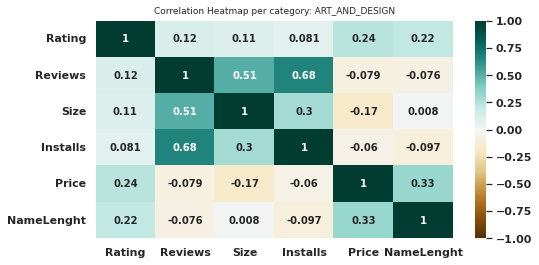

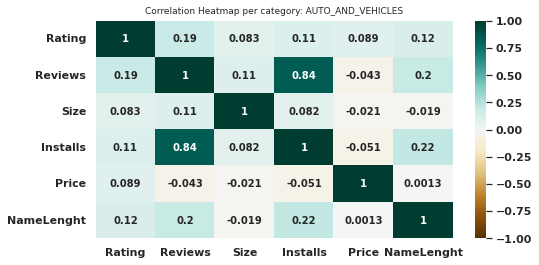

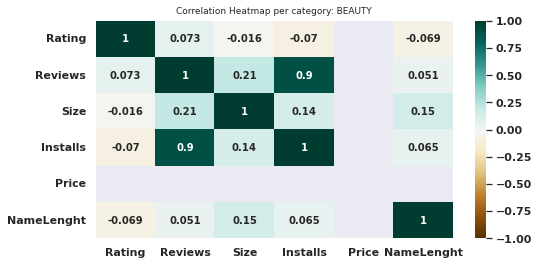

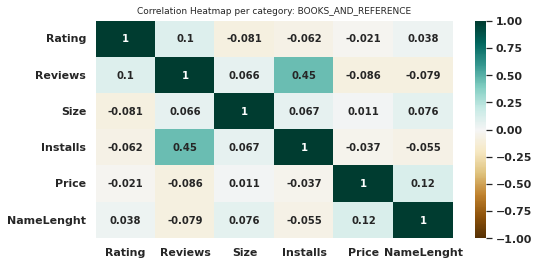

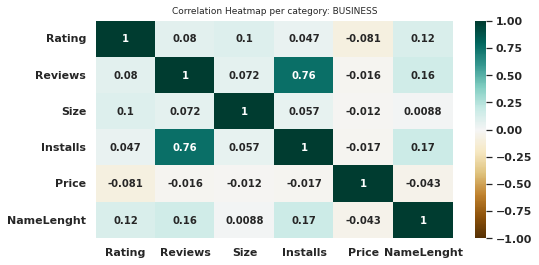

...

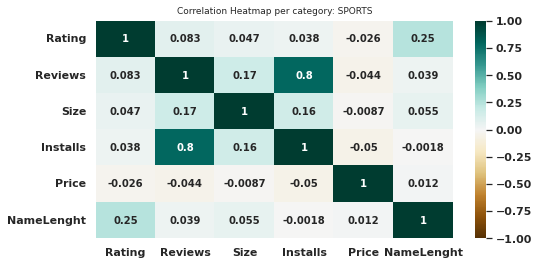

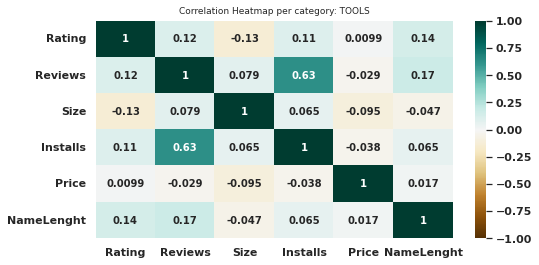

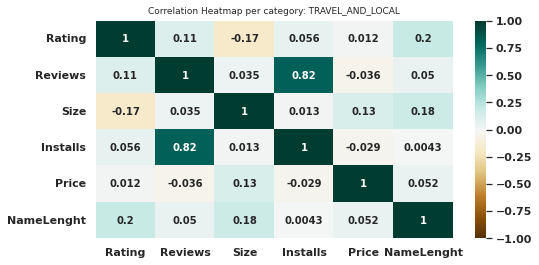

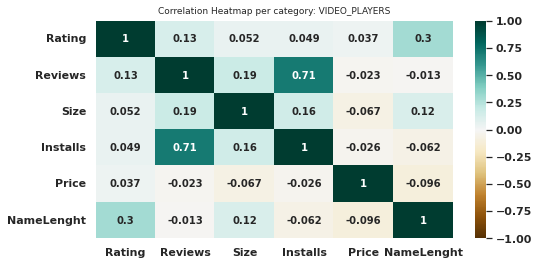

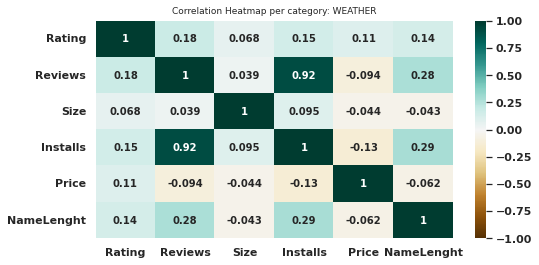

In [1079]:
#Heatmaps für jede Kategorie
plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_ART_AND_DESIGN.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: ART_AND_DESIGN', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_AUTO_AND_VEHICLES.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: AUTO_AND_VEHICLES', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_BEAUTY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: BEAUTY', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_BOOKS_AND_REFERENCE.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: BOOKS_AND_REFERENCE', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_BUSINESS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: BUSINESS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_COMICS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: COMICS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_COMMUNICATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: COMMUNICATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_DATING.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: DATING', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_EDUCATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: EDUCATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_ENTERTAINMENT.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: ENTERTAINMENT', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_EVENTS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: EVENTS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_FAMILY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: FAMILY', fontdict={'fontsize':9}, pad=7);


plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_FINANCE.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: FINANCE', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_FOOD_AND_DRINK.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: FOOD_AND_DRINK', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_GAME.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: GAME', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_HEALTH_AND_FITNESS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: HEALTH_AND_FITNESS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_HOUSE_AND_HOME.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: HOUSE_AND_HOME', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_LIBRARIES_AND_DEMO.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: LIBRARIES_AND_DEMO', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_LIFESTYLE.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: LIFESTYLE', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_MAPS_AND_NAVIGATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: MAPS_AND_NAVIGATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_MEDICAL.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: MEDICAL', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_NEWS_AND_MAGAZINES.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: NEWS_AND_MAGAZINES', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PARENTING.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PARENTING', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PERSONALIZATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PERSONALIZATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PHOTOGRAPHY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PHOTOGRAPHY', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PRODUCTIVITY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PRODUCTIVITY', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_SHOPPING.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: SHOPPING', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_SOCIAL.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: SOCIAL', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_SPORTS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: SPORTS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_TOOLS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: TOOLS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_TRAVEL_AND_LOCAL.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: TRAVEL_AND_LOCAL', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_VIDEO_PLAYERS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: VIDEO_PLAYERS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_WEATHER.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: WEATHER', fontdict={'fontsize':9}, pad=7);



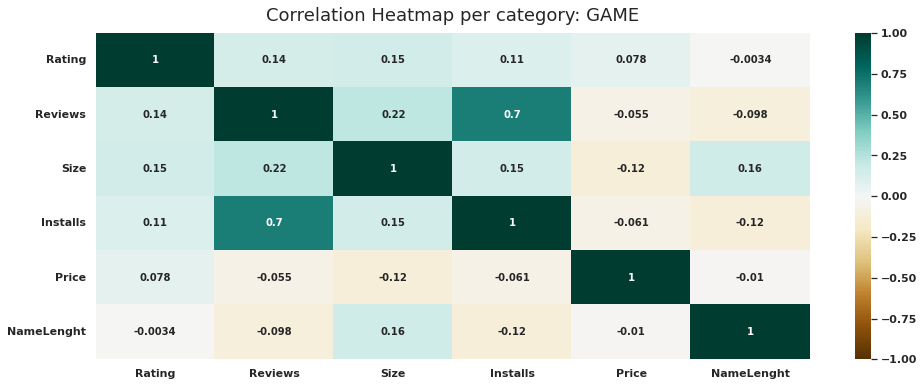

In [1080]:
#Correlation Heatmap der ausgewählten Kategorie- Game
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(cat_GAME.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: GAME', fontdict={'fontsize':18}, pad=12);

# Define categories

In [1081]:
#Kategorie "Game" definieren
cat_GAME = rawdata[(rawdata.Category == 'GAME')]

In [1082]:
#Median der Installationen in der Kategorie "Game"
cat_GAME['Installs'].median()

1000000.0

In [1083]:
#Median der Ratings in der Kategorie "Game"
cat_GAME['Rating'].median()

4.3

In [1084]:
#Median der Größen in der Kategorie "Game"
cat_GAME['Size'].median()

38.0

In [1085]:
#Länge der Namen auch für Kategorie "Game" definieren
rawdata['NameLenght'] = rawdata['App'].apply(len)

#Kostenfreie und kostenpflichtige Spiele definieren
cat_FREE_raw = rawdata[rawdata.Type == 'Free']
cat_PAID_raw = rawdata[rawdata.Type == 'Paid']

#Erfolg definieren: Wenn mehr Installationen als Median (>1000000) und besseres Rating als Median (>4.3)
cat_GAME['Successful'] = (np.where((cat_GAME['Installs']>= 1000000) & (cat_GAME['Rating']>= 4.3), 'Successful', 'Unsuccessful'))

#"Großes Spiel" definieren: Wenn größer als Median (38 MB)
cat_GAME['BigGame'] = np.where(cat_GAME['Size']>= 38, 1, 0)


In [1086]:
#Kategorie "Game" anzeigen
display(cat_GAME)

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,NameLenght,Successful,BigGame
1653,ROBLOX,GAME,4.5,4447388,67.0,1.000000e+08,Free,0.0,Everyone 10+,Adventure;Action & Adventure,"July 31, 2018",2.347.225742,4.1 and up,6,Successful,1
1654,Subway Surfers,GAME,4.5,27722264,76.0,1.000000e+09,Free,0.0,Everyone 10+,Arcade,"July 12, 2018",1.90.0,4.1 and up,14,Successful,1
1655,Candy Crush Saga,GAME,4.4,22426677,74.0,5.000000e+08,Free,0.0,Everyone,Casual,"July 5, 2018",1.129.0.2,4.1 and up,16,Successful,1
1656,Solitaire,GAME,4.7,254258,23.0,1.000000e+07,Free,0.0,Everyone,Card,"August 1, 2018",2.137.0,4.1 and up,9,Successful,0
1657,Bubble Shooter,GAME,4.5,148897,46.0,1.000000e+07,Free,0.0,Everyone,Casual,"July 17, 2018",1.20.1,4.0.3 and up,14,Successful,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10791,Winter Wonderland,GAME,4.0,1287,38.0,5.000000e+04,Free,0.0,Everyone,Word,"December 18, 2013",1.0,2.2 and up,17,Unsuccessful,1
10792,Soccer Clubs Logo Quiz,GAME,4.2,21661,16.0,1.000000e+06,Free,0.0,Everyone,Trivia,"May 24, 2018",1.3.81,4.0 and up,22,Unsuccessful,0
10793,Sid Story,GAME,4.4,28510,78.0,5.000000e+05,Free,0.0,Teen,Card,"August 1, 2018",2.6.6,4.0.3 and up,9,Unsuccessful,1
10803,Fatal Raid - No.1 Mobile FPS,GAME,4.3,56496,81.0,1.000000e+06,Free,0.0,Teen,Action,"August 7, 2018",1.5.447,4.0 and up,28,Successful,1


# Data division

In [1087]:
#Datensatz in zwei Sets aufteilen. 80% Trainingsset und 20% Testset
data=rawdata.sample(frac=0.8,random_state=200)
test_data=rawdata.drop(data.index)

In [1088]:
#Info: Anzahl aller Apps (Trainingsset + Testset) 
rawdata.App.count()
cat_PAID_raw.App.count()
cat_FREE_raw.App.count()
print("\nAnzahl aller Apps  : ", rawdata.App.count())
print("\ndavon Kostenpflichtig : ", cat_PAID_raw.App.count())
print("\ndavon Kostenlos : ", cat_FREE_raw.App.count())


Anzahl aller Apps  :  9659

davon Kostenpflichtig :  756

davon Kostenlos :  8902


In [1089]:
#Info: Anzahl der Trainingsset-Apps
data.App.count()
cat_FREE_data = data[data.Type == 'Free']
cat_PAID_data = data[data.Type == 'Paid']
print("\nAnzahl ausgewählter (80%) Apps  : ", data.App.count())
print("\ndavon Kostenpflichtig : ", cat_PAID_data.App.count())
print("\ndavon Kostenlos : ", cat_FREE_data.App.count())


Anzahl ausgewählter (80%) Apps  :  7727

davon Kostenpflichtig :  595

davon Kostenlos :  7132


#  Data preparation for further analysis

In [1090]:
#Kategorie Game (Trainingsset)
cat_GAME_ready = data[(data.Category == 'GAME')]

In [1091]:
#Überprüfung der Daten
cat_GAME_ready

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,NameLenght
6563,Sic Bo Rave,GAME,3.9,164,33.0,10000.0,Free,0.00,Teen,Card,"September 23, 2013",1.0.1,2.3.3 and up,11
6835,BU HANGİ ŞARKI ? - 2018,GAME,NaN,4,28.0,100.0,Free,0.00,Everyone,Trivia,"June 2, 2018",3.1.7z,4.0.3 and up,23
9611,Big Fish Casino – Play Slots & Vegas Games,GAME,4.4,382100,NaN,10000000.0,Free,0.00,Teen,Casino,"July 11, 2018",Varies with device,Varies with device,42
1776,Color Road,GAME,4.1,84911,71.0,10000000.0,Free,0.00,Everyone,Arcade,"July 19, 2018",2.5.0,4.1 and up,10
9584,Texas Hold’em Poker + | Social,GAME,3.5,4416,59.0,500000.0,Free,0.00,Teen,Casino,"January 18, 2017",2.1.7,4.0.3 and up,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4820,Z Champions,GAME,4.7,96028,59.0,1000000.0,Free,0.00,Teen,Arcade,"May 28, 2018",Varies with device,4.0 and up,11
6574,Sic Bo (Tai Xiu) - Multiplayer Casino,GAME,4.2,152,16.0,10000.0,Free,0.00,Teen,Casino,"July 8, 2018",2.1.2,4.1 and up,37
5846,YAKALA AY,GAME,NaN,0,14.0,1.0,Paid,0.99,Everyone,Arcade,"July 7, 2018",1.0,4.1 and up,9
4999,AE Bingo: Offline Bingo Games,GAME,4.4,61746,NaN,500000.0,Free,0.00,Teen,Casino,"September 30, 2016",Varies with device,2.3.3 and up,29


In [1092]:
#Median der Installationen in der Kategorie "Game" (Trainingsset)
cat_GAME_ready['Installs'].median()

1000000.0

In [1093]:
#Median der Ratings in der Kategorie "Game" (Trainingsset)
cat_GAME_ready['Rating'].median()

4.3

In [1094]:
#Median der Größen in der Kategorie "Game" (Trainingsset)
cat_GAME_ready['Size'].median()

39.0

In [1095]:
#Länge der Namen definieren und als Spalte anzeigen (Trainingsset)
data['NameLenght'] = data['App'].apply(len)

#"Erfolg" definieren (Trainingsset)
cat_GAME_ready['Successful'] = (np.where((cat_GAME_ready['Installs']>= 1000000) & (cat_GAME_ready['Rating']>= 4.3), 'Successful', 'Unsuccessful'))

#"Großes Spiel" definieren (Trainingsset)
cat_GAME_ready['BigGame'] = np.where(cat_GAME_ready['Size']>= 39, 1, 0)

In [1096]:
#Unerwünschte Werte entfernen (na, NaN, usw.)
cat_GAME_ready.dropna(inplace = True)

In [1097]:
# Features und Target variables definieren
feature_cols = ["Price", "BigGame", "NameLenght"]

X = cat_GAME_ready[feature_cols] # Features
Y = cat_GAME_ready.Successful # Target variable
cat_GAME_ready.head


<bound method NDFrame.head of                                         App Category  ...    Successful  BigGame
6563                            Sic Bo Rave     GAME  ...  Unsuccessful        0
1776                             Color Road     GAME  ...  Unsuccessful        1
9584         Texas Hold’em Poker + | Social     GAME  ...  Unsuccessful        1
9609                     Texas Holdem Poker     GAME  ...  Unsuccessful        0
8673                             that's lit     GAME  ...  Unsuccessful        1
...                                     ...      ...  ...           ...      ...
9464              Fast Racing Car Simulator     GAME  ...  Unsuccessful        1
9561                             Fernanfloo     GAME  ...    Successful        1
4820                            Z Champions     GAME  ...    Successful        1
6574  Sic Bo (Tai Xiu) - Multiplayer Casino     GAME  ...  Unsuccessful        0
6719                           Block Strike     GAME  ...    Successful        

In [1098]:
#Trainings- und Testdatensatz für die Algorhythmen (90% Training and 10% Test)
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.1, random_state=1) 

In [1099]:
#Info: Testset überprüfen
X_test

,Price,BigGame,NameLenght
1679,0.0,1,6
6694,0.0,0,30
6979,0.0,0,21
8770,0.0,0,10
8625,0.0,1,29
...,...,...,...
6084,0.0,1,22
5541,0.0,1,46
10783,0.0,1,44
5652,0.0,0,30


# Decision Tree

In [1100]:
#Entscheidungsbaum-Klassifikatorobjekt erstellen
clf1 = DecisionTreeClassifier()

# Entscheidungsbaum-Klassifikator trainieren
clf1 = clf1.fit(X_train,y_train)

#Die Antwort für den Testdatensatz vorhersagen
y_pred1 = clf1.predict(X_test)

In [1101]:
#Modellgenauigkeit: Wie oft ist der Klassifikator korrekt?
print("Accuracy: DT1",metrics.accuracy_score(y_test, y_pred1))

Accuracy: DT1 0.5970149253731343


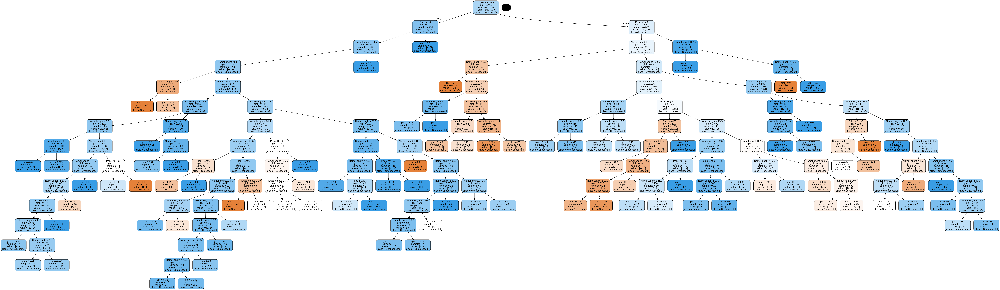

In [1102]:
#Entscheidungsbaum  visualisieren
dot_data = StringIO()
export_graphviz(clf1, out_file=dot_data,  
filled=True, rounded=True,
special_characters=True, feature_names = feature_cols,class_names=["Successful", "Unsuccessful"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('DT.png')
Image(graph.create_png())

Text(48.49999999999999, 0.5, 'True Class')

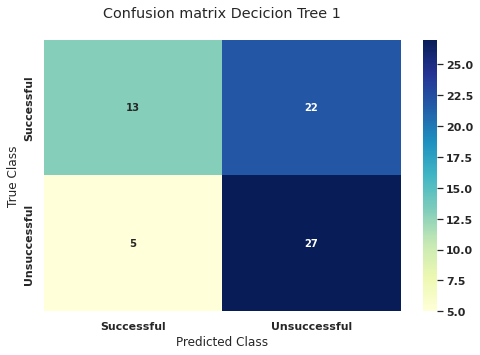

In [1103]:
#Confusion Matrix für Decision Tree 1
cm_DT1=confusion_matrix(y_test,y_pred1)
conf_matrix=pd.DataFrame(data=cm_DT1,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Decicion Tree 1\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

Text(0.5, 1.0, 'Total Impurity vs effective alpha for training set')

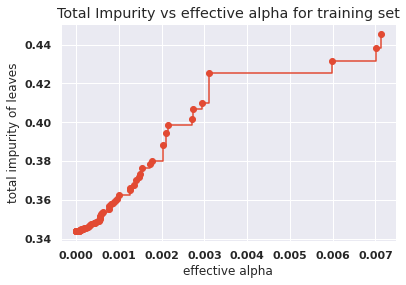

In [1104]:
#Optimierung: Die schwächste Verbindung wird durch ein effektives Alpha gekennzeichnet, wobei die Knoten mit dem kleinsten effektiven Alpha zuerst beschnitten werden
path = clf1.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

#In der folgenden Darstellung wird der maximale effektive Alphawert entfernt, da es sich um den Trivialbaum mit nur einem Knoten handelt

fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")

In [1105]:
#Einen Entscheidungsbaum unter Verwendung der effektiven Alphas trainieren
clfs = []
for ccp_alpha in ccp_alphas:
    clf1 = DecisionTreeClassifier(random_state=0, ccp_alpha=ccp_alpha)
    clf1.fit(X_train, y_train)
    clfs.append(clf1)
print("Number of nodes in the last tree is: {} with ccp_alpha: {}".format(
        clfs[-1].tree_.node_count, ccp_alphas[-1] ))

Number of nodes in the last tree is: 1 with ccp_alpha: 0.017103235133842154


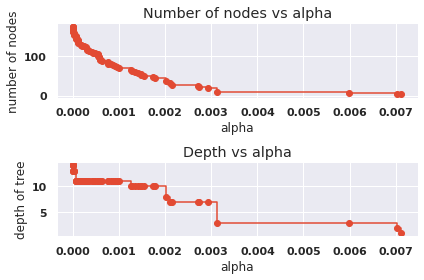

In [1106]:
#Die Anzahl der Knoten und die Tiefe des Baumes nimmt mit zunehmendem Alpha ab
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]

node_counts = [clf1.tree_.node_count for clf1 in clfs]
depth = [clf1.tree_.max_depth for clf1 in clfs]
fig, ax = plt.subplots(2, 1)
ax[0].plot(ccp_alphas, node_counts, marker="o", drawstyle="steps-post")
ax[0].set_xlabel("alpha")
ax[0].set_ylabel("number of nodes")
ax[0].set_title("Number of nodes vs alpha")
ax[1].plot(ccp_alphas, depth, marker="o", drawstyle="steps-post")
ax[1].set_xlabel("alpha")
ax[1].set_ylabel("depth of tree")
ax[1].set_title("Depth vs alpha")
fig.tight_layout()

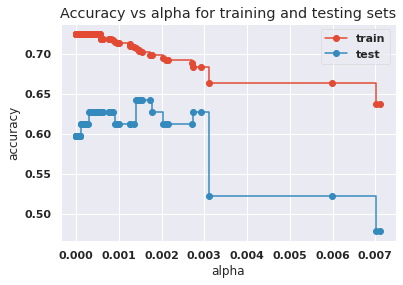

In [1107]:
#Den optimalen Wert für Alpha ermitteln
train_scores = [clf1.score(X_train, y_train) for clf1 in clfs]
test_scores = [clf1.score(X_test, y_test) for clf1 in clfs]

fig, ax = plt.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker="o", label="train", drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker="o", label="test", drawstyle="steps-post")
ax.legend()
plt.show()

In [1108]:
#Neuer Entscheidungsbaum mit effektivem Alpha
clf2 = DecisionTreeClassifier(random_state=0, ccp_alpha=0.0031) 
clf2 = clf2.fit(X_train,y_train)
y_pred2 = clf2.predict(X_test) 

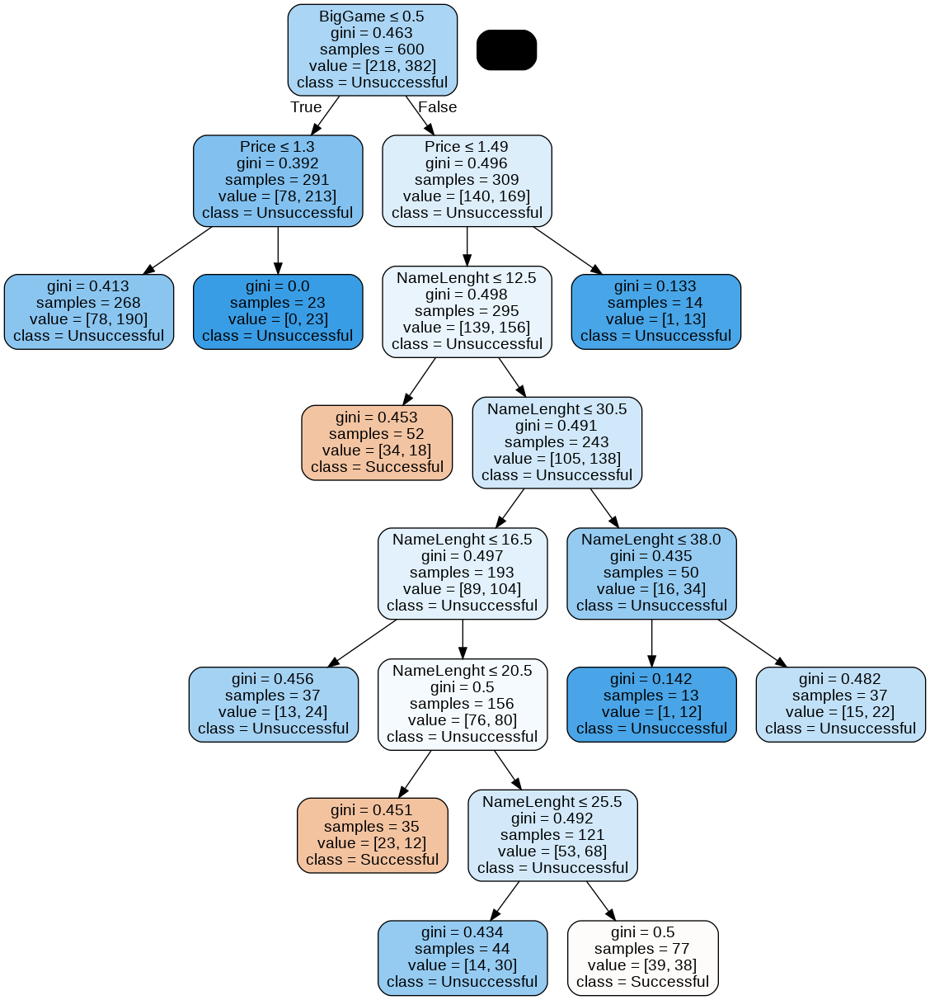

In [1109]:
#Entscheidungsbaum 2 visualisieren
dot_data = StringIO()
export_graphviz(clf2, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=["Successful","Unsuccessful"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('decisciontree.png')
Image(graph.create_png())

In [1110]:
#Modellgenauigkeit: Wie oft ist der Klassifikator(DT2) korrekt?
DT2_Accuracy = metrics.accuracy_score(y_test, y_pred2)
print("Accuracy DT2:",round(DT2_Accuracy*100,2),"%")

Accuracy DT2: 62.69 %


Text(48.49999999999999, 0.5, 'True Class')

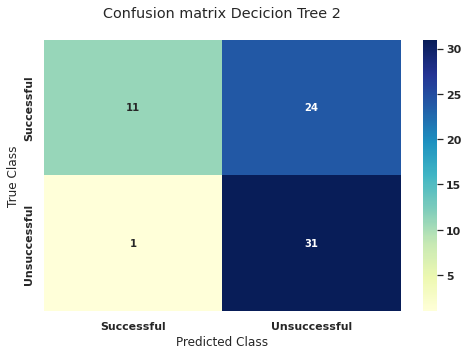

In [1111]:
#Confusion Matrix für Decision Tree 2
cm_DT2=confusion_matrix(y_test,y_pred2)
conf_matrix=pd.DataFrame(data=cm_DT2,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Decicion Tree 2\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

# K-Nearest Neighbor

In [1112]:
#Die optimale Anzahl der Neighbors ermitteln
error_rate = []

for i in range(1,40):
 
 knn = KNeighborsClassifier(n_neighbors=i)
 knn.fit(X_train,y_train)
 pred_i = knn.predict(X_test)
 error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

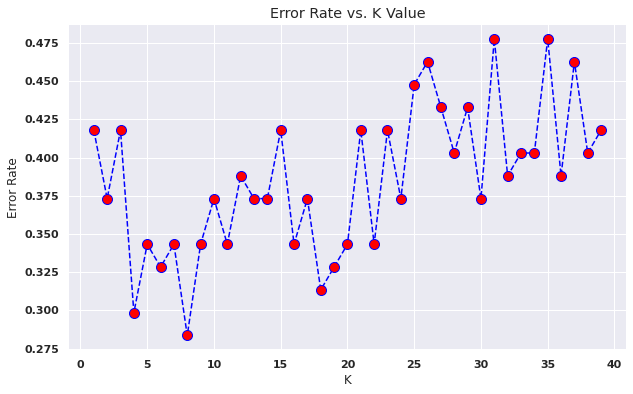

In [1113]:
#Visualisierung der Ergebnisse
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
 markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [1114]:
#KNN-Analyse

knn = KNeighborsClassifier(n_neighbors=8)

knn.fit(X_train, y_train)

y_pred3 = knn.predict(X_test)

#Modellgenauigkeit: Wie oft ist der Klassifikator korrekt?
acc = accuracy_score(y_test, y_pred3)
print(f"The accuracy score for KNN is: {np.round(acc,3)*100}%")


# f1 score: Die F1-Punktzahl kann als gewichteter Durchschnitt der Präzision und der Wiederauffindbarkeit interpretiert werden, wobei eine F1-Punktzahl ihren besten Wert bei 1 und ihren schlechtesten Wert bei 0 erreicht.
f1 = f1_score(y_test, y_pred3, pos_label= 'Successful')

print(f"The f1 score for KNN is: {np.round(f1,3)*100}%")
#print(f1)

# Precision Score: Wie oft liegt sie richtig, wenn sie ja vorhersagt? Präzision=True Positive/Vorhersage ja
precision = precision_score(y_test, y_pred3, pos_label= 'Successful')
print(f"The precision score for KNN is: {round(precision,3)*100}%")

# recall score: True-Positive-Rate (Empfindlichkeit oder Rückruf): Wie oft sagt sie "ja" voraus, wenn sie tatsächlich "ja" ist? Wahr-Positiv-Rate = Wahr-Positiv/eigentliches Ja
recall = recall_score(y_test, y_pred3, pos_label= 'Successful')
print(f"The recall score for KNN is: {round(recall,3)*100}%")

The accuracy score for KNN is: 71.6%
The f1 score for KNN is: 65.5%
The precision score for KNN is: 90.0%
The recall score for KNN is: 51.4%


In [1115]:
#Überprüfung der Überanpassung des KNN-Modells
acc_test = knn.score(X_test, y_test)
print("The accuracy score of the test data is:--> ",acc_test*100,"%") 
acc_train = knn.score(X_train, y_train)
print("The accuracy score of the training data is: ",round(acc_train*100,2),"%")

The accuracy score of the test data is:-->  71.64179104477611 %
The accuracy score of the training data is:  69.33 %


In [1116]:
#Die Ergebnisse für Test- und Trainingsdaten für das KNN-Modell sind ähnlich. Daher erwarten wir keine Überanpassung des Modells.

In [1117]:
#Modellgenauigkeit: Wie oft ist der Klassifikator korrekt?
KNN_Accuracy = knn.score(X_test, y_test)
print("Accuracy KNN:",round(KNN_Accuracy*100,2),"%")

Accuracy KNN: 71.64 %


Text(48.49999999999999, 0.5, 'True Class')

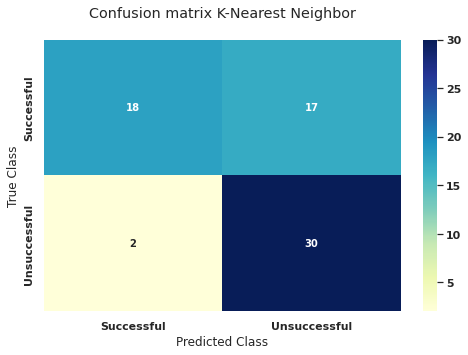

In [1118]:
# Confusion Matrix für KNN
cm_KNN=confusion_matrix(y_test, y_pred3) 
conf_matrix=pd.DataFrame(data=cm_KNN,columns=['Successful', 'Unsuccessful'],index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix K-Nearest Neighbor\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

# Support Vector Machine

In [1119]:
#Datenvorbereitung für SVM
data_SVM_raw = cat_GAME_ready

In [1120]:
#Datenvorbereitung für SVM
data_SVM_raw.drop(['App', 'Category', 'Rating', 'Reviews', 'Size', 'Installs', 'Type', 'Content Rating', 
              'Genres', 'Last Updated', 'Current Ver', 'Android Ver'], axis=1)

,Price,NameLenght,Successful,BigGame
6563,0.0,11,Unsuccessful,0
1776,0.0,10,Unsuccessful,1
9584,0.0,30,Unsuccessful,1
9609,0.0,18,Unsuccessful,0
8673,0.0,10,Unsuccessful,1
...,...,...,...,...
9464,0.0,25,Unsuccessful,1
9561,0.0,10,Successful,1
4820,0.0,11,Successful,1
6574,0.0,37,Unsuccessful,0


In [1121]:
#Support Vestor Machine Analyse
classifier = SVC(kernel='rbf', random_state = 1)
classifier.fit(X_train,y_train)

y_pred4 = classifier.predict(X_test)

X_test["Predictions"] = y_pred4

In [1122]:
#Modellgenauigkeit: Wie oft ist der Klassifikator korrekt?
SVM_Accuracy = float(cm.diagonal().sum())/len(y_test)
print("\nAccuracy Of SVM For The Given Dataset : ", SVM_Accuracy)


Accuracy Of SVM For The Given Dataset :  0.47761194029850745


Text(48.49999999999999, 0.5, 'True Class')

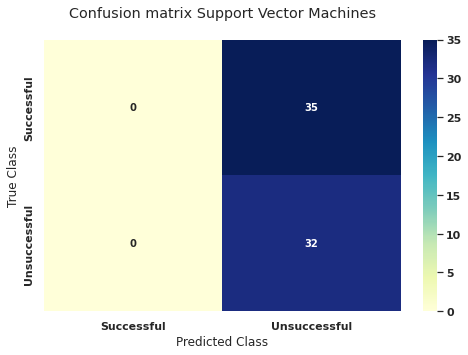

In [1123]:
#Confusion Matrix für SVM
cm_SVM=confusion_matrix(y_test,y_pred4)
conf_matrix=pd.DataFrame(data=cm_SVM,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Support Vector Machines\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

# Compare

In [1124]:
#Genauigkeiten aller Modelle anzeigen (Trainingsset)
print("Accuracy:DT1",round(DT1_Accuracy*100,2),"%")
print("Accuracy:DT2",round(DT2_Accuracy*100,2),"%")
print("Accuracy:KNN",round(KNN_Accuracy*100,2),"%")
print("Accuracy:SVM",round(SVM_Accuracy*100,2),"%")


Accuracy:DT1 59.7 %
Accuracy:DT2 62.69 %
Accuracy:KNN 71.64 %
Accuracy:SVM 47.76 %


Text(48.49999999999999, 0.5, 'True Class')

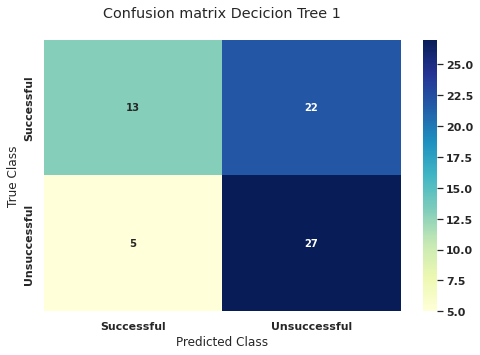

In [1125]:
#Confusion Matrix für Decision Tree 1
cm_DT1=confusion_matrix(y_test,y_pred1)
conf_matrix=pd.DataFrame(data=cm_DT1,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Decicion Tree 1\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')



Text(48.49999999999999, 0.5, 'True Class')

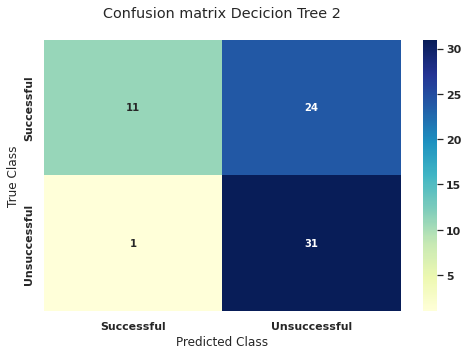

In [1126]:
#Confusion Matrix für Decision Tree 2
cm_DT2=confusion_matrix(y_test,y_pred2)
conf_matrix=pd.DataFrame(data=cm_DT2,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Decicion Tree 2\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

Text(48.49999999999999, 0.5, 'True Class')

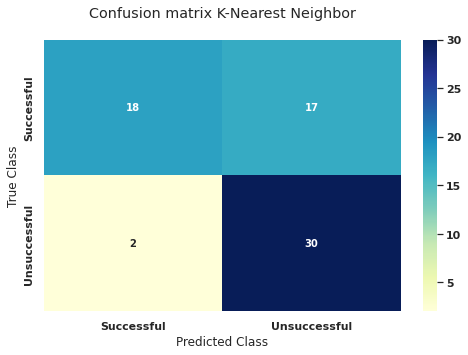

In [1127]:
#Confusion Matrix für KNN
cm_KNN=confusion_matrix(y_test, y_pred3) 
conf_matrix=pd.DataFrame(data=cm_KNN,columns=['Successful', 'Unsuccessful'],index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix K-Nearest Neighbor\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

Text(48.49999999999999, 0.5, 'True Class')

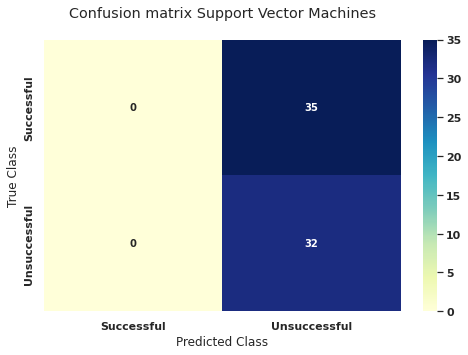

In [1128]:
#Confusion Matrix für SVM
cm_SVM=confusion_matrix(y_test,y_pred4)
conf_matrix=pd.DataFrame(data=cm_SVM,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Support Vector Machines\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

# Validation

In [1129]:
#Vorbereitung des Test-Datensatzes, identisch, wie bei dem Trainingsdatensatz
cat_GAME_validation = test_data[(test_data.Category == 'GAME')]

cat_GAME_validation['Successful'] = (np.where((cat_GAME_validation['Installs']>= 1000000) & (cat_GAME_validation['Rating']>= 4.3), 'Successful', 'Unsuccessful'))

cat_GAME_validation['BigGame'] = np.where(cat_GAME_validation['Size']>= 38, 1, 0)

cat_GAME_validation.dropna(inplace = True)

X_val = cat_GAME_validation[feature_cols] # Features
Y_val = cat_GAME_validation[["Successful"]]

In [1130]:
#Info: Test-Datensatz
cat_GAME_validation

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,NameLenght,Successful,BigGame
1664,Block Puzzle,GAME,4.6,59800,7.8,5000000.0,Free,0.0,Everyone,Puzzle,"March 6, 2018",2.9,2.3 and up,12,Successful,0
1670,Clash of Clans,GAME,4.6,44891723,98.0,100000000.0,Free,0.0,Everyone 10+,Strategy,"July 15, 2018",10.322.16,4.1 and up,14,Successful,1
1672,Block Puzzle Classic Legend !,GAME,4.2,17039,4.9,5000000.0,Free,0.0,Everyone,Puzzle,"April 13, 2018",2.9,2.3.3 and up,29,Unsuccessful,0
1675,8 Ball Pool,GAME,4.5,14198297,52.0,100000000.0,Free,0.0,Everyone,Sports,"July 31, 2018",4.0.0,4.0.3 and up,11,Successful,1
1682,Race the Traffic Moto,GAME,3.8,270687,38.0,10000000.0,Free,0.0,Teen,Racing,"July 20, 2018",1.0.16,4.0.3 and up,21,Unsuccessful,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10703,Fo Fo Fish,GAME,3.4,5,21.0,50.0,Free,0.0,Everyone,Arcade,"August 25, 2015",1.0,2.3 and up,10,Unsuccessful,0
10776,Monster Ride Pro,GAME,5.0,1,24.0,10.0,Free,0.0,Everyone,Racing,"March 5, 2018",2.0,2.3 and up,16,Unsuccessful,0
10791,Winter Wonderland,GAME,4.0,1287,38.0,50000.0,Free,0.0,Everyone,Word,"December 18, 2013",1.0,2.2 and up,17,Unsuccessful,1
10793,Sid Story,GAME,4.4,28510,78.0,500000.0,Free,0.0,Teen,Card,"August 1, 2018",2.6.6,4.0.3 and up,9,Unsuccessful,1


In [1131]:
# Decision Tree auf Validierungsdatensatz anpassen
clf1 = clf1.fit(X_val,Y_val)
# Vorhersage für Validierungsdatensatz bestimmen
y_pred_val1 = clf1.predict(X_val)

In [1132]:
#Modellgenauigkeit: Decision Tree 1 (Testsatz)
DT1_Accuracy_Val = metrics.accuracy_score(Y_val, y_pred_val1)
print("Accuracy DT1_Val:",round(DT1_Accuracy_Val*100,2),"%")

Accuracy DT1_Val: 75.15 %


Text(48.49999999999999, 0.5, 'True Class')

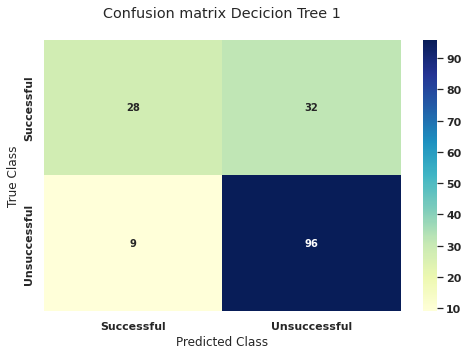

In [1133]:
# Erstellung Confusion Matrix Decision Tree 1 (Test)
cm_DT1_validated=confusion_matrix(Y_val,y_pred_val1)
conf_matrix=pd.DataFrame(data=cm_DT1_validated,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Decicion Tree 1\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

In [1134]:
# Decision Tree auf Validierungsdatensatz anpassen
clf2 = clf2.fit(X_val,Y_val)
# Vorhersage für Validierungsdatensatz bestimmen
y_pred_val2 = clf2.predict(X_val)

In [1135]:
#Modellgenauigkeit: Decision Tree 2 (Testsatz) 
DT2_Accuracy_Val = metrics.accuracy_score(Y_val, y_pred_val2)
print("Accuracy DT2_Val:",round(DT2_Accuracy_Val*100,2),"%")

Accuracy DT2_Val: 83.03 %


Text(48.49999999999999, 0.5, 'True Class')

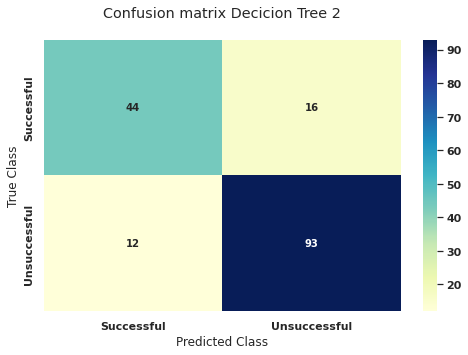

In [1136]:
#Erstellung Confusion Matrix Decision Tree 2 (Test)
cm_DT2_validated=confusion_matrix(Y_val,y_pred_val2)
conf_matrix=pd.DataFrame(data=cm_DT2_validated,columns=['Successful', 'Unsuccessful'], index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Decicion Tree 2\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

In [1137]:
#KNN auf Validierungsdatensatz anpassen
knn = knn.fit(X_val, Y_val)
#Vorhersage für Validierungsdatensatz bestimmen
y_pred_val3 = knn.predict(X_val)

In [1138]:
#Modellgenauigkeit: KNN (Testsatz)
KNN_Accuracy_Val = metrics.accuracy_score(Y_val, y_pred_val3)
print("Accuracy KNN_Val:",round(KNN_Accuracy_Val*100,2),"%")

Accuracy KNN_Val: 73.33 %


Text(48.49999999999999, 0.5, 'True Class')

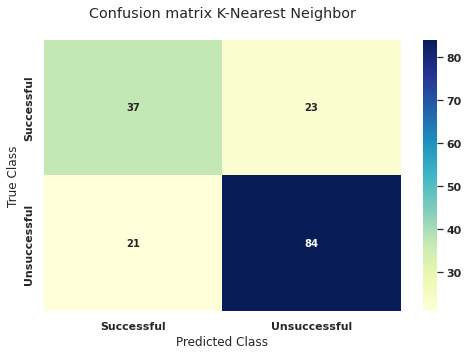

In [1139]:
#Erstellung Confusion Matrix KNN (Test)
cm_KNN=confusion_matrix(Y_val, y_pred_val3) 
conf_matrix=pd.DataFrame(data=cm_KNN,columns=['Successful', 'Unsuccessful'],index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix K-Nearest Neighbor\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

In [1140]:
#SVM auf Validierungsdatensatz anpassen
SVM = classifier.fit(X_val, Y_val)
#Vorhersage für Validierungsdatensatz bestimmen
y_pred_val4 = classifier.predict(X_val)

In [1141]:
#Modellgenauigkeit: SVM (Testsatz)
SVM_Accuracy_Val = metrics.accuracy_score(Y_val, y_pred_val4)
print("Accuracy SVM_Val:",round(SVM_Accuracy_Val*100,2),"%")

Accuracy SVM_Val: 63.64 %


Text(48.49999999999999, 0.5, 'True Class')

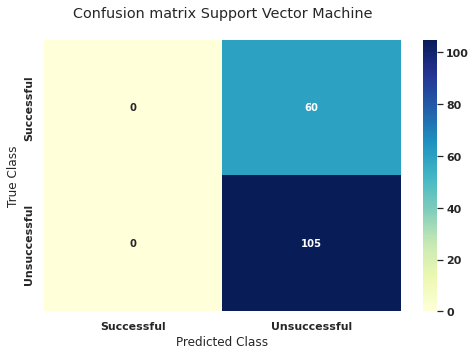

In [1142]:
#Erstellung Confusion Matrix SVM (Test)
cm_SVM=confusion_matrix(Y_val, y_pred_val4) 
conf_matrix=pd.DataFrame(data=cm_SVM,columns=['Successful', 'Unsuccessful'],index=['Successful','Unsuccessful'])
plt.figure(figsize = (8,5))
sns.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")
plt.title('Confusion matrix Support Vector Machine\n', y=1.1)
ax= plt.subplot()
ax.set_xlabel('Predicted Class');ax.set_ylabel('True Class')

In [1143]:
#Genauigkeiten aller Modelle anzeigen (Trainingsset)
print("Accuracy DT1_Val:",round(DT1_Accuracy_Val*100,2),"%")
print("Accuracy DT2_Val:",round(DT2_Accuracy_Val*100,2),"%")
print("Accuracy KNN_Val:",round(KNN_Accuracy_Val*100,2),"%")
print("Accuracy SVM_Val:",round(SVM_Accuracy_Val*100,2),"%")

Accuracy DT1_Val: 75.15 %
Accuracy DT2_Val: 83.03 %
Accuracy KNN_Val: 73.33 %
Accuracy SVM_Val: 63.64 %


# Model in use

In [1144]:
#Anwendungsmodell
def start_questionnaire():
    my_predictors = []
    parameters=["Price", "BigGame", "NameLenght", "Successful"]
    
    print('Input Future App Information:')
    
    Price = input("Price of App: >>> ")  
    my_predictors.append(Price)
    BigGame = input("Big Game? yes=1, no=0: >>> ") 
    my_predictors.append(BigGame)
    NameLenght = input("Lenght of the App name: >>> ") 
    my_predictors.append(NameLenght)

  
    #
    my_data = dict(zip(parameters, my_predictors))
    my_df = pd.DataFrame(my_data, index=[0])
    scaler = MinMaxScaler(feature_range=(0,1)) 

    # assign scaler to column:
    my_df_scaled = pd.DataFrame(scaler.fit_transform(my_df), 
                                columns=my_df.columns)
    my_y_pred = clf2.predict(my_df_scaled)
    print('\n')
    print('Result:')
    #print(my_y_pred)

    if my_y_pred == 'Successful':
        print("Successful.")
    if my_y_pred == 'Unsuccessful':
        print("Unsuccessful.")
        
start_questionnaire()


Input Future App Information:
Price of App: >>> 1
Big Game? yes=1, no=0: >>> 1
Lenght of the App name: >>> 14


Result:
Unsuccessful.


In [1161]:
# !jupyter nbconvert /content/GooglePlayStore.ipynb

In [1162]:
# !sudo apt-get install textlive-xetex textlive-fonts-recommended textlive-plain-generic 

In [1163]:
# !jupyter nbconvert --to pdf GooglePlayStore.ipynb

In [ ]:
!wget -nc https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
from colab_pdf import colab_pdf
colab_pdf('Predicting_Hearth_disease.ipynb')